# EV smart charging under uncertainty

_Walkthrough of function interaction_

### Version requirements

- Python					3.8.3

- matplotlib 				3.3.2

- numpy 					1.19.3

- pandas                  1.1.4

- scikit-learn			0.23.2

- seaborn					0.11.0

- statsmodels				0.12.0

- tensorflow				2.2.0

- keras 					2.4.3

- gurobi 					9.0.3

- pickle					0.7.5


### Librairy imports

In [2]:
import pickle
import time
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os

## Data import

- Import function to process data from df_prepare.py

In [3]:
folder_path = os.getcwd()+'/'
print(folder_path)

C:\Users\Yann\Documents\EPFL\pdm_git\pdm_git\Main/


In [4]:
# Function to import data
from df_prepare import data_PV_csv, data_EV_csv

In [5]:
PV_csv = 'pv_simulation_evolene.csv'
data_PV = data_PV_csv(folder_path + PV_csv)

EV_csv = '/ev_simulation_evolene.csv'
data_EV = data_EV_csv(folder_path +EV_csv)

## Forecasting

### Load Forecasting

In [6]:
import warnings
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARMA',
                        FutureWarning)
warnings.filterwarnings("ignore")

- Import Forecast ARMA class

In [7]:
import Forecast_Class
from Forecast_Class import Forecast_ARMA

- Select variable to predict:

In [8]:
pred_variable = 'load'

- Declare instance

In [9]:
Load_model_forecast = Forecast_ARMA(data_EV, pred_variable = pred_variable)

#### Predict on Average

- Plot autocorrelation

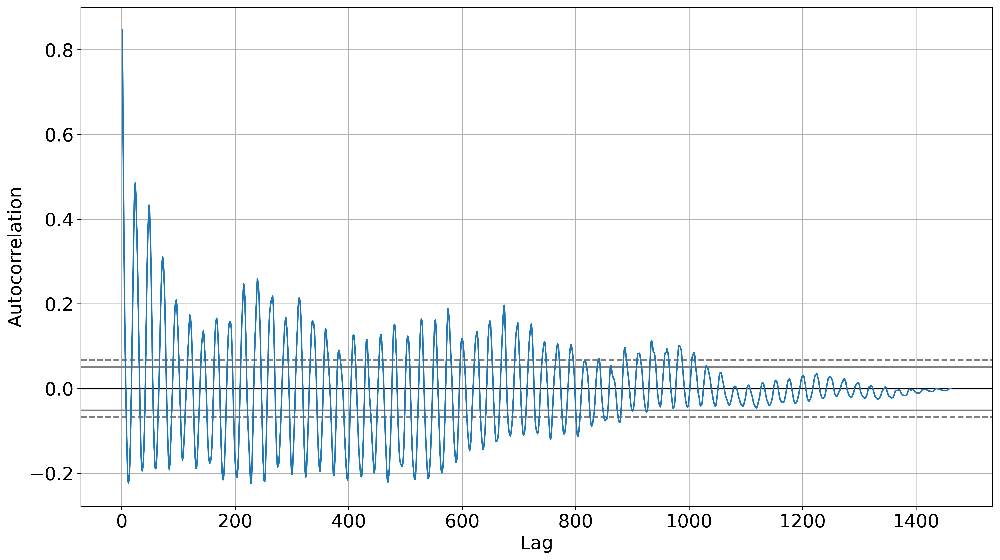

In [10]:
Load_model_forecast.plot_autocorrelation()

 _Evaluate the S parameter (if k = 24 hours)_

- Decide whether to carry the evaluation (True or False)

In [11]:
evaluate_stats_models = True

- S values to evaluate

In [12]:
S = 14

- Run

S: 1, MSE: 22571770.666666668, time: 2.6153
S: 2, MSE: 18052960.0, time: 1.8931
S: 3, MSE: 17876312.0, time: 2.0161
S: 4, MSE: 18489098.666666668, time: 1.5551
S: 5, MSE: 18868212.0, time: 2.5811
S: 6, MSE: 19188041.333333332, time: 3.3078
S: 7, MSE: 19152156.0, time: 2.9281
S: 8, MSE: 19196144.0, time: 2.8385
S: 9, MSE: 18777841.333333332, time: 3.6835
S: 10, MSE: 18398564.0, time: 3.1274
S: 11, MSE: 18246124.0, time: 3.4163
S: 12, MSE: 18316054.666666668, time: 2.6074
S: 13, MSE: 18164438.666666668, time: 3.6524
Best S: 3, MSE: 17876312.0


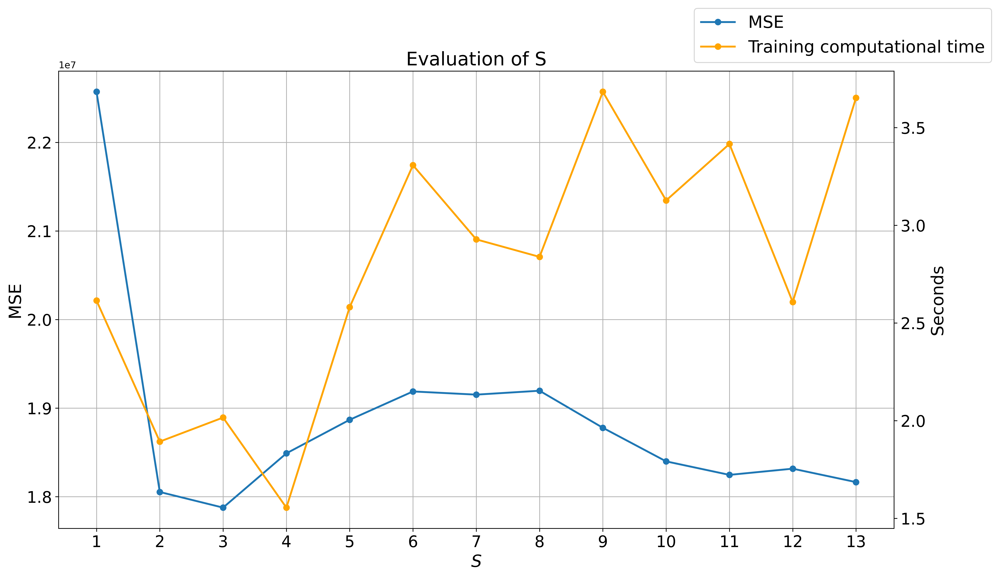

In [13]:
S_values = np.arange(1,S)
if evaluate_stats_models:
    best_S, best_score = Load_model_forecast.evaluate_predict_with_stats(S_values)

#### ARMA

- Decide wether to evaluate (p,q)

In [14]:
evaluate_ARMA_models = True

- p and q values

In [15]:
p = 3
q = 3

- Run

ARMA(0, 0) MSE=17291761.96, time: 3.15s
ARMA(0, 1) MSE=8273178.29, time: 26.81s
ARMA(0, 2) MSE=5883747.23, time: 57.13s
ARMA(1, 0) MSE=5315719.99, time: 23.83s
ARMA(1, 1) MSE=5109886.63, time: 103.6s


C:\Users\Yann\anaconda3\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  ConvergenceWarning)


ARMA(1, 2) MSE=5099862.79, time: 130.67s
ARMA(2, 0) MSE=5052601.49, time: 65.5s


C:\Users\Yann\anaconda3\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  ConvergenceWarning)


ARMA(2, 1) MSE=5024928.96, time: 226.67s
ARMA(2, 2) MSE=5059684.96, time: 311.29s
Best: ARMA(2, 1) MSE=5024928.96


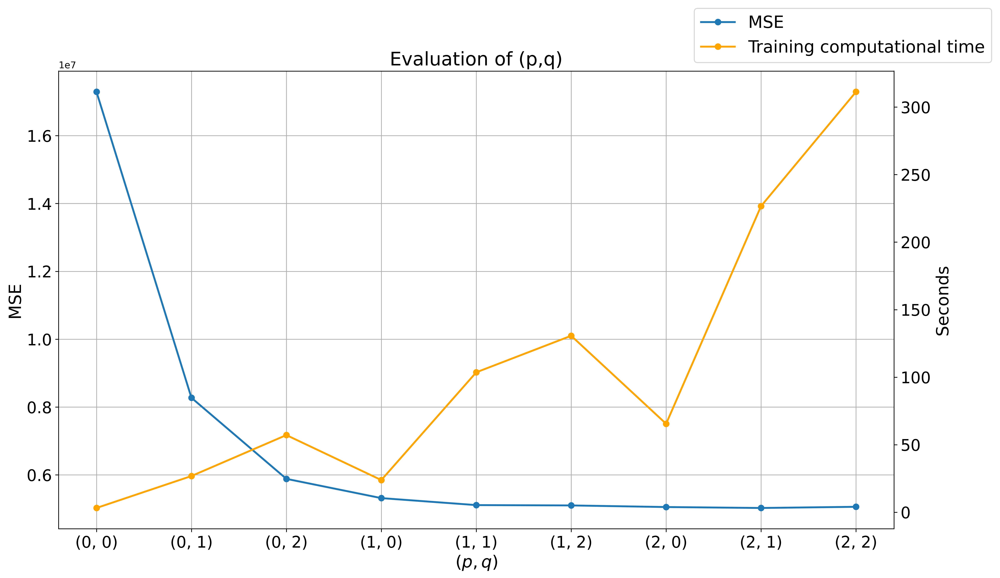

In [16]:
if evaluate_ARMA_models:    
    p_values = np.arange(p)
    q_values = np.arange(q)

    results = Load_model_forecast.evaluate_ARMA_models(p_values, q_values)

### PV forecasting

- Import LSTM forecast class

In [17]:
from Forecast_Class import Forecast_LSTM

- Choose hyperparameters

In [18]:
n_hour_future = 23

n_hour_past = 48

pred_variable = 'DCPmp'

epochs = 50

batch_size = 72

test_days = 21

- Run LSTM building (only useful if you want to run the optimization

In [19]:
run_LSTM = True

Epoch 1/50
134/134 [==============================] - 19s 140ms/step - loss: 0.0541
Epoch 2/50
134/134 [==============================] - 16s 118ms/step - loss: 0.0196
Epoch 3/50
134/134 [==============================] - 15s 111ms/step - loss: 0.0141
Epoch 4/50
134/134 [==============================] - 19s 143ms/step - loss: 0.0126
Epoch 5/50
134/134 [==============================] - 17s 125ms/step - loss: 0.0121
Epoch 6/50
134/134 [==============================] - 15s 112ms/step - loss: 0.0116
Epoch 7/50
134/134 [==============================] - 16s 116ms/step - loss: 0.0112
Epoch 8/50
134/134 [==============================] - 15s 114ms/step - loss: 0.0111
Epoch 9/50
134/134 [==============================] - 15s 112ms/step - loss: 0.0108
Epoch 10/50
134/134 [==============================] - 15s 115ms/step - loss: 0.0106
Epoch 11/50
134/134 [==============================] - 16s 116ms/step - loss: 0.0105
Epoch 12/50
134/134 [==============================] - 16s 116ms/step - lo

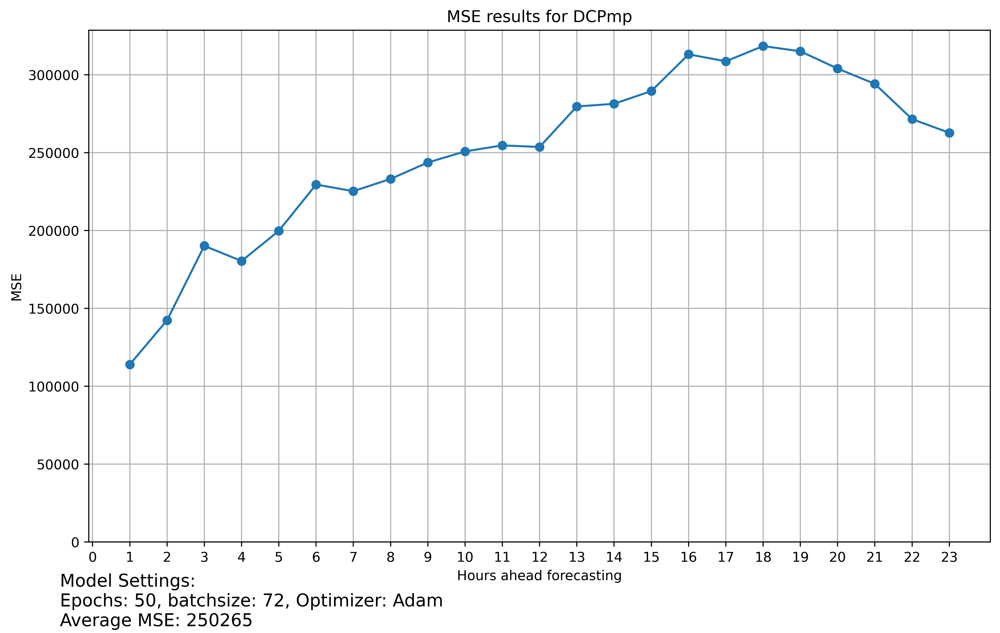

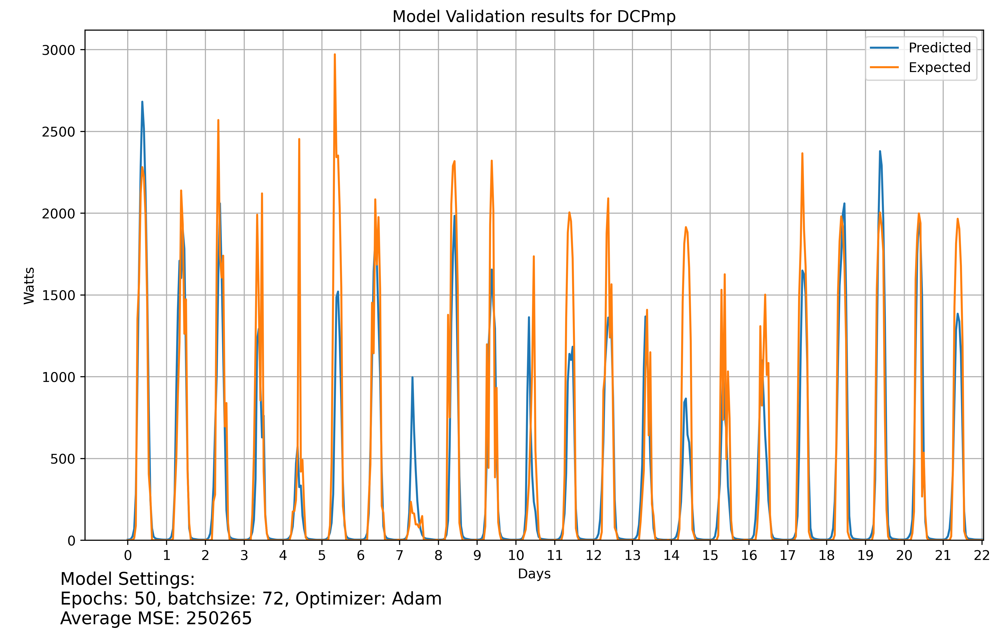

In [20]:
if run_LSTM:
    # keep the training data up to the start of the test
    data_PV_train = data_PV[:data_EV.index[0]]
    
    # instantiate class
    PV_model_forecast = Forecast_LSTM(pred_variable = pred_variable, data = data_PV,  n_hour_future = n_hour_future, 
                                      n_hour_past = n_hour_past, test_days = test_days)
    # get time resolution
    t_res = PV_model_forecast.t_res
    
    # build lstm
    PV_model_forecast.build_LSTM(epochs = epochs, plot_results=True)
    PV_LSTM = PV_model_forecast.LSTM_model



- Decide whether evaluate dropouts and the values to evaluate

In [21]:
evaluate_dropouts = True

- Parameters

In [22]:
# valiation length
validation_days = 10

num_scenarios = 20

# dropouts to be tested
dropouts = [0.2,0.3,0.4,0.5, 0.6]

In [23]:
if evaluate_dropouts:
    
    idx_start = int(len(data_PV_train) - (validation_days + 2)*24*t_res)
    
    # return deterministic and stochastic predictions
    pred_det, pred_sto = PV_model_forecast.uncertainty_evaluation(model = PV_LSTM,test_days = validation_days,
                                                                 idx_start = idx_start,dropouts = dropouts,
                                                                  n_iterations = num_scenarios)
    

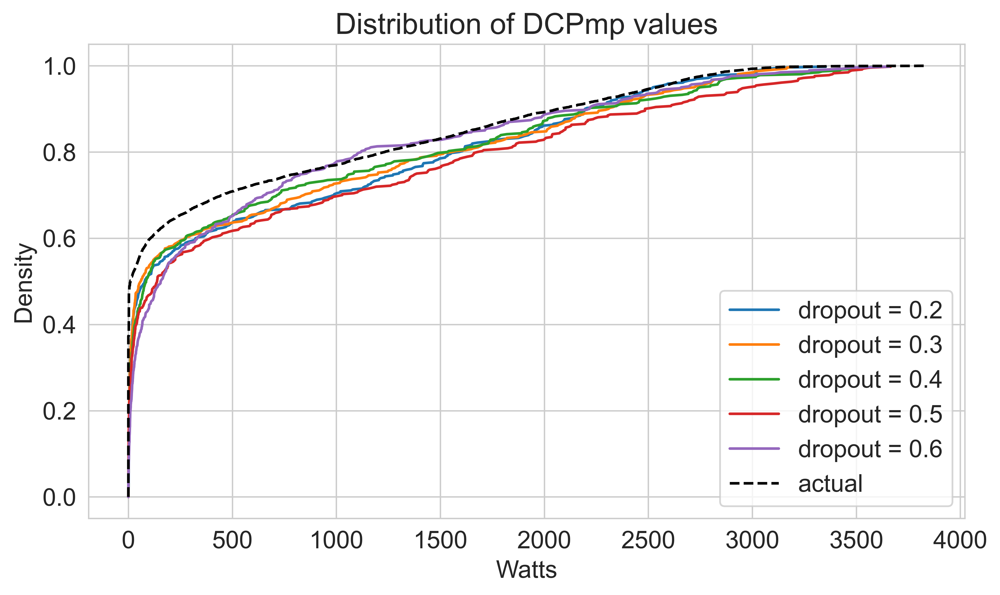

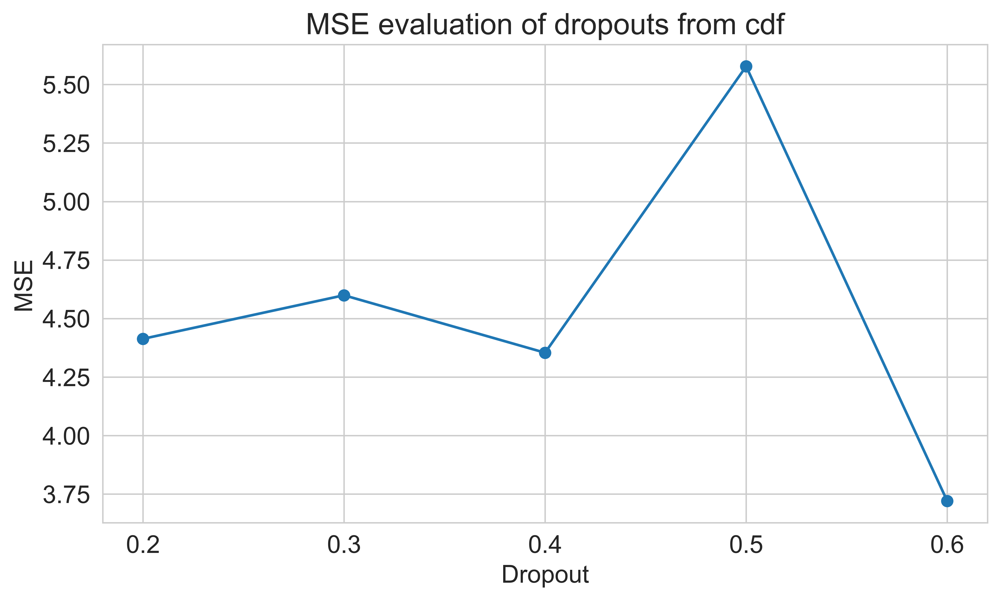

In [24]:
if evaluate_dropouts:
    from plot_res import plot_dropout_results
    plot_dropout_results(data_PV_train,pred_variable, pred_det, pred_sto, n_hour_future, 
                         plot_cumulative = True)

- Plot results from best dropout

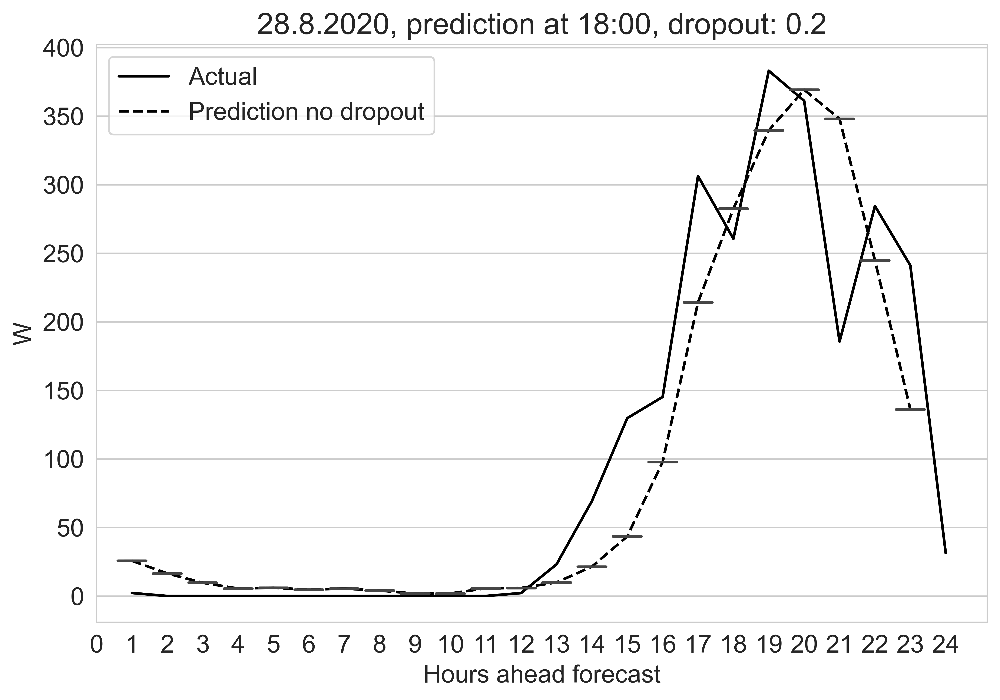

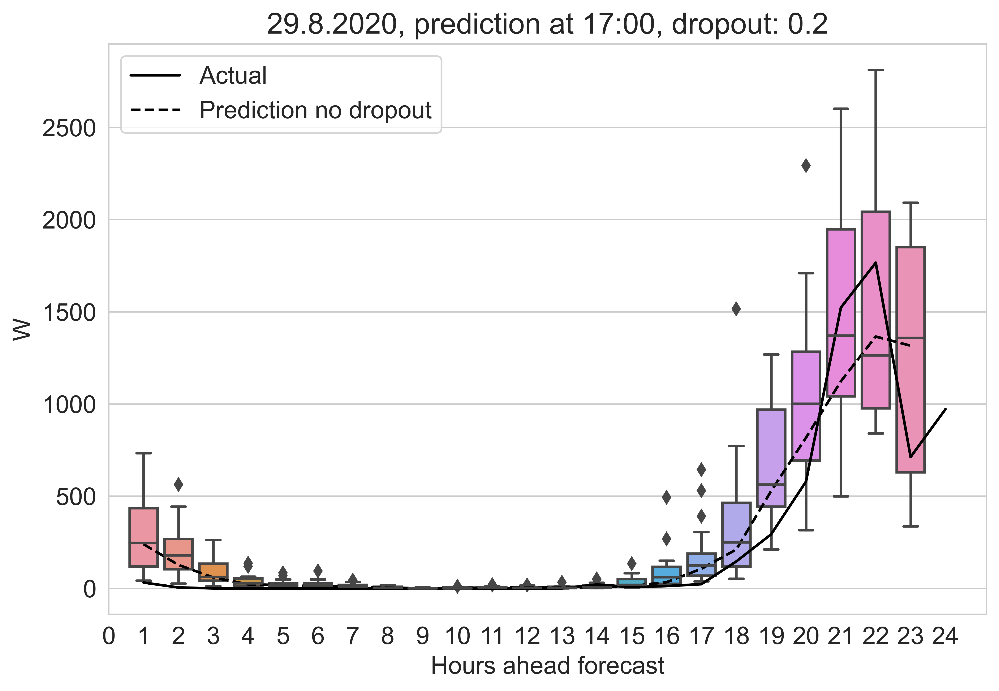

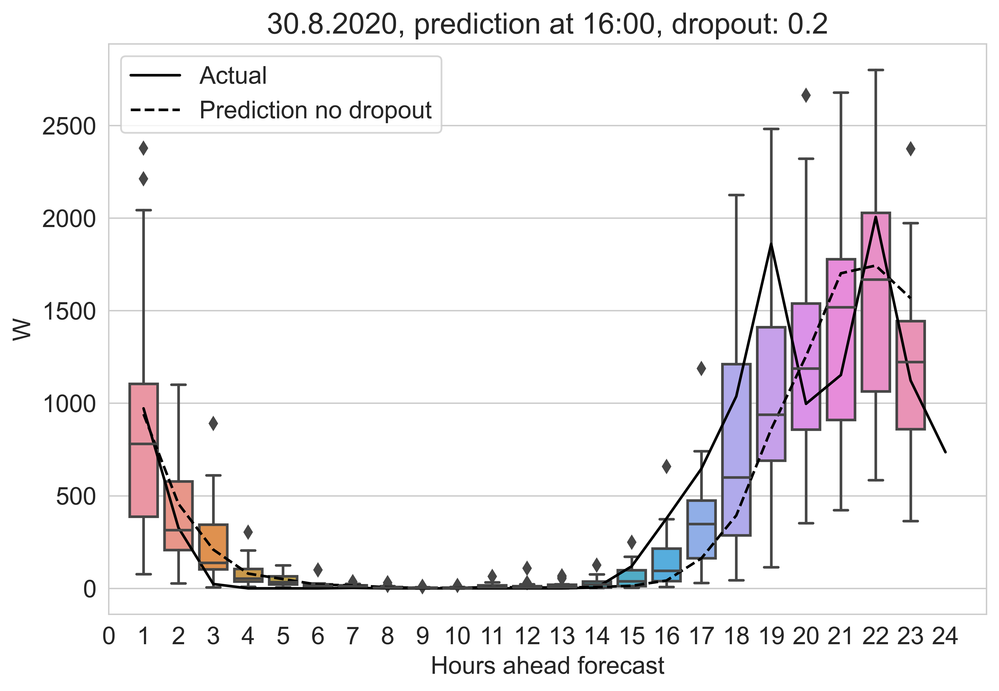

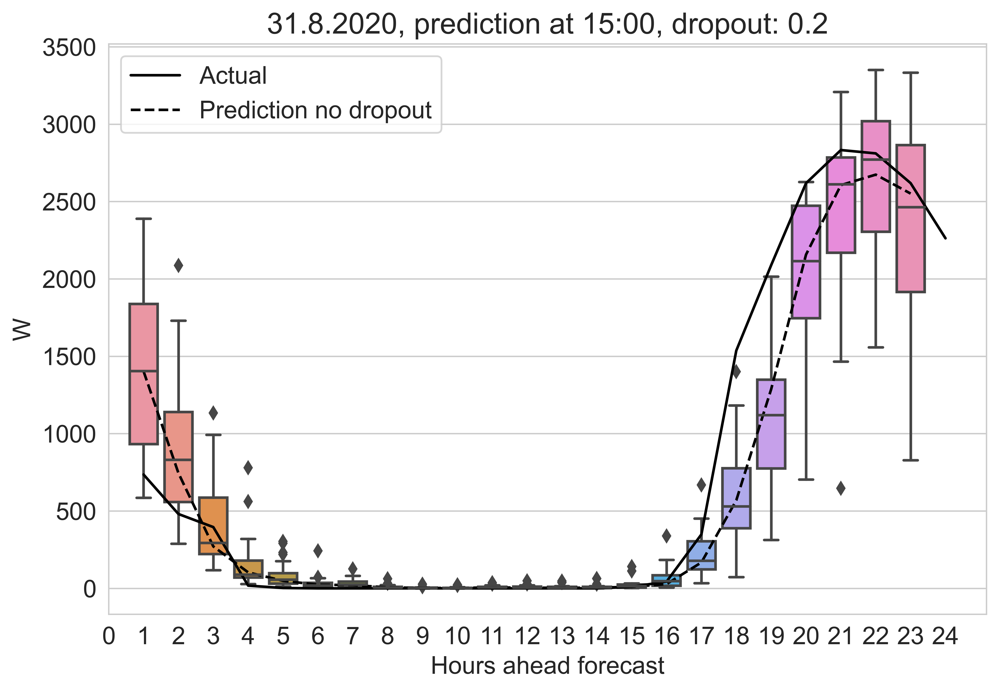

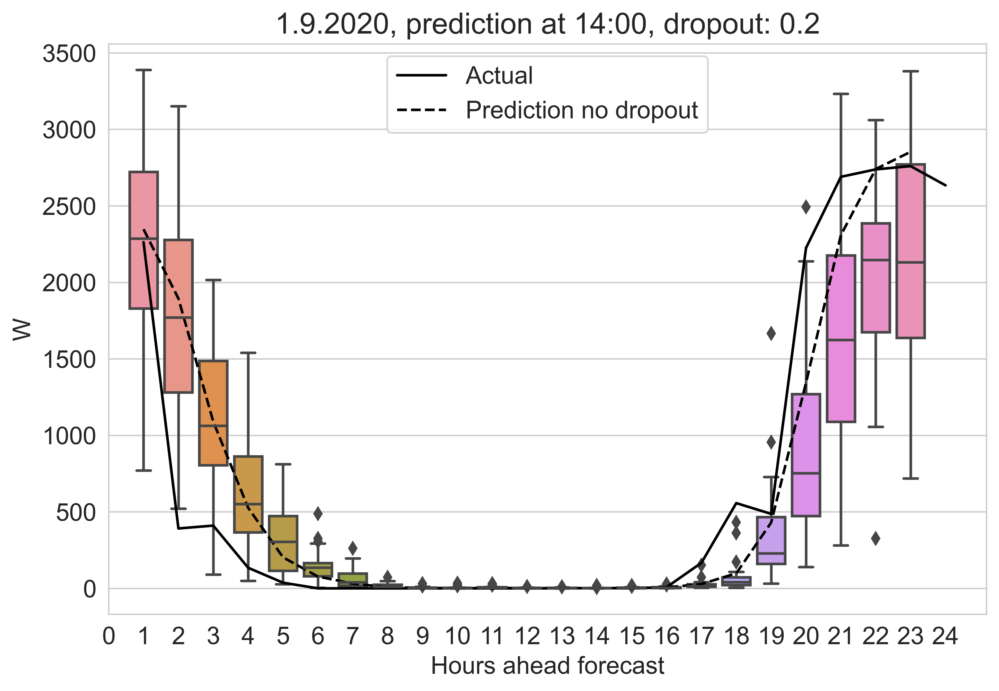

...

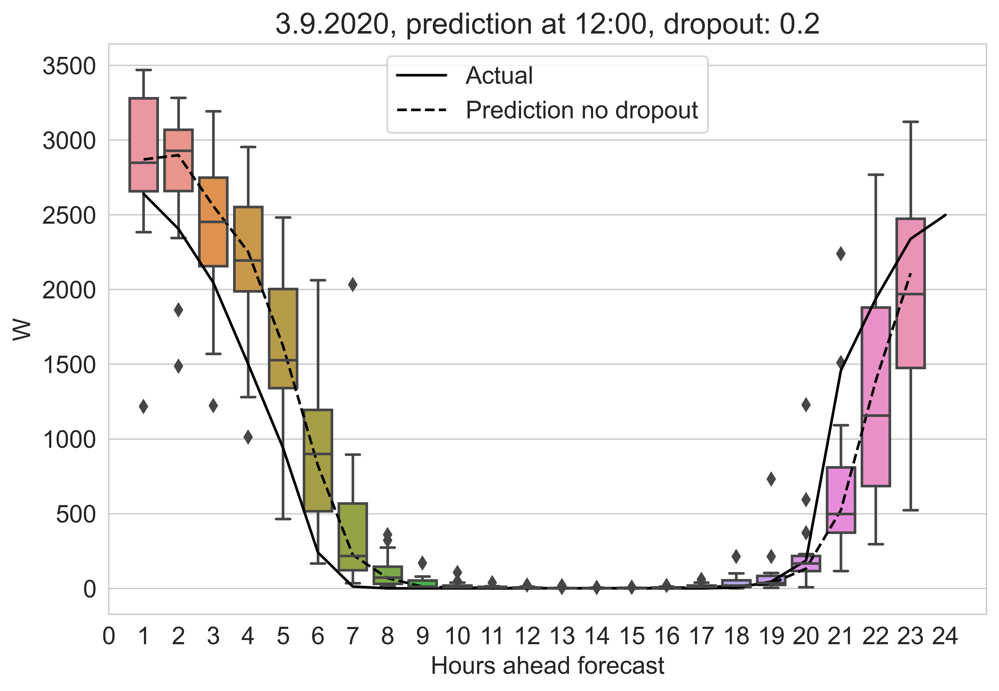

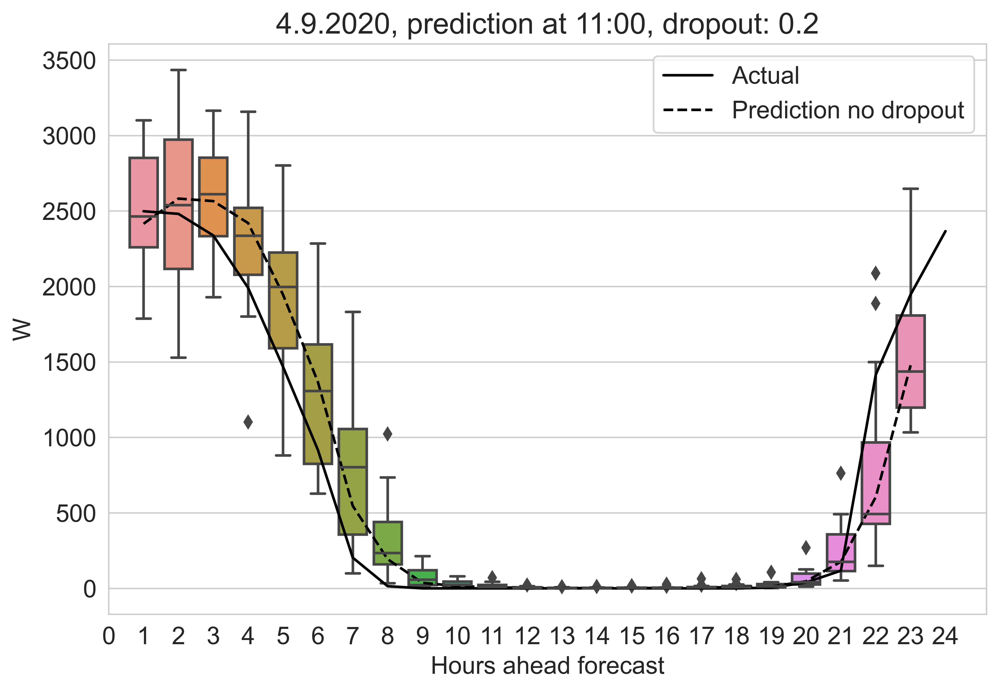

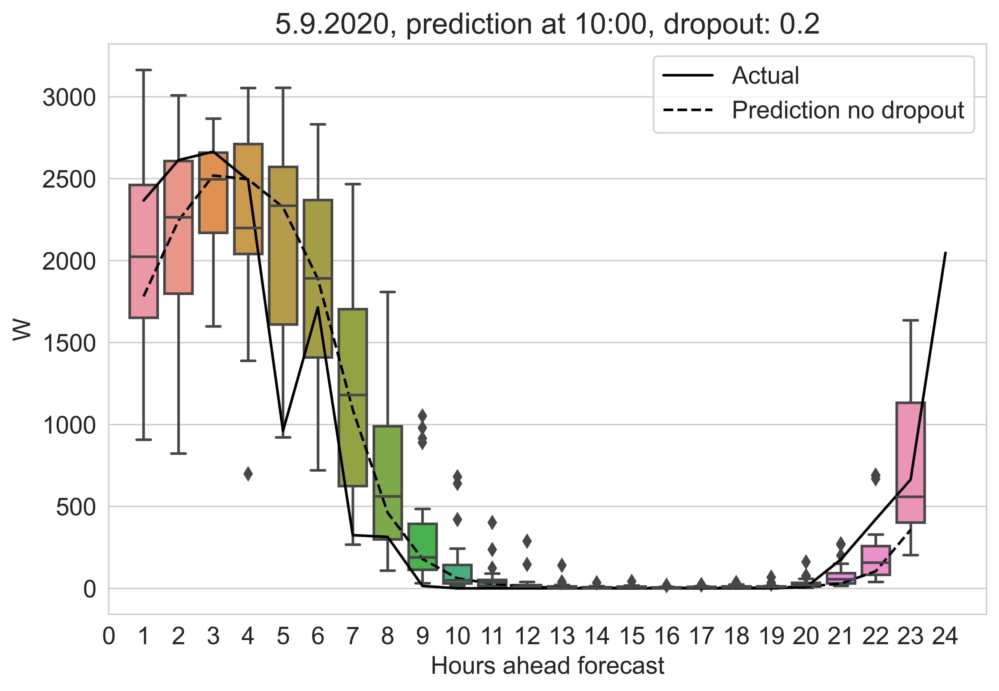

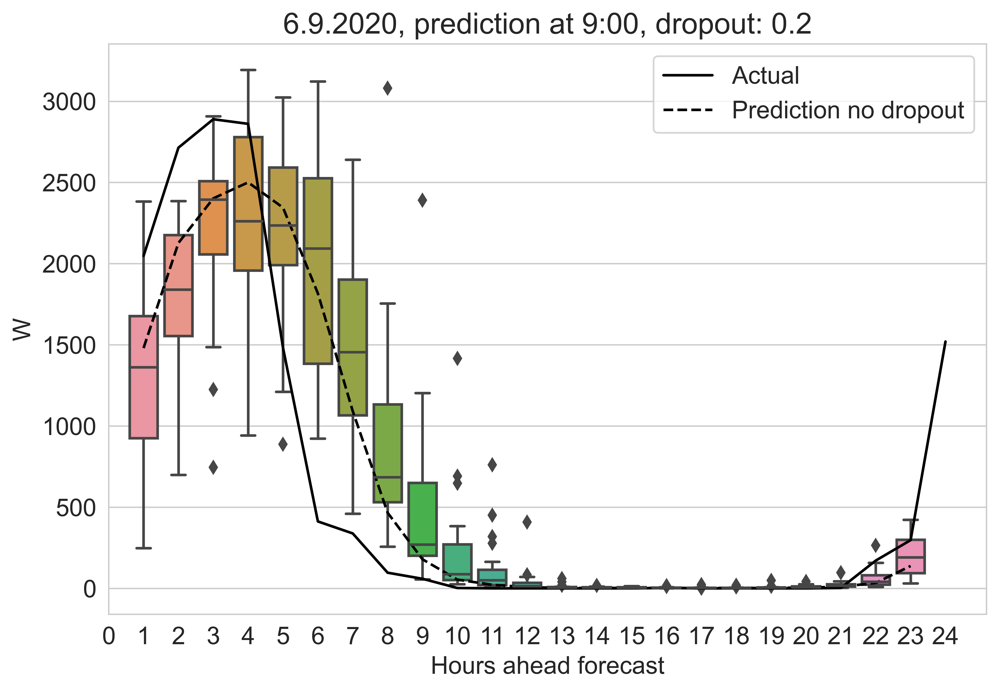

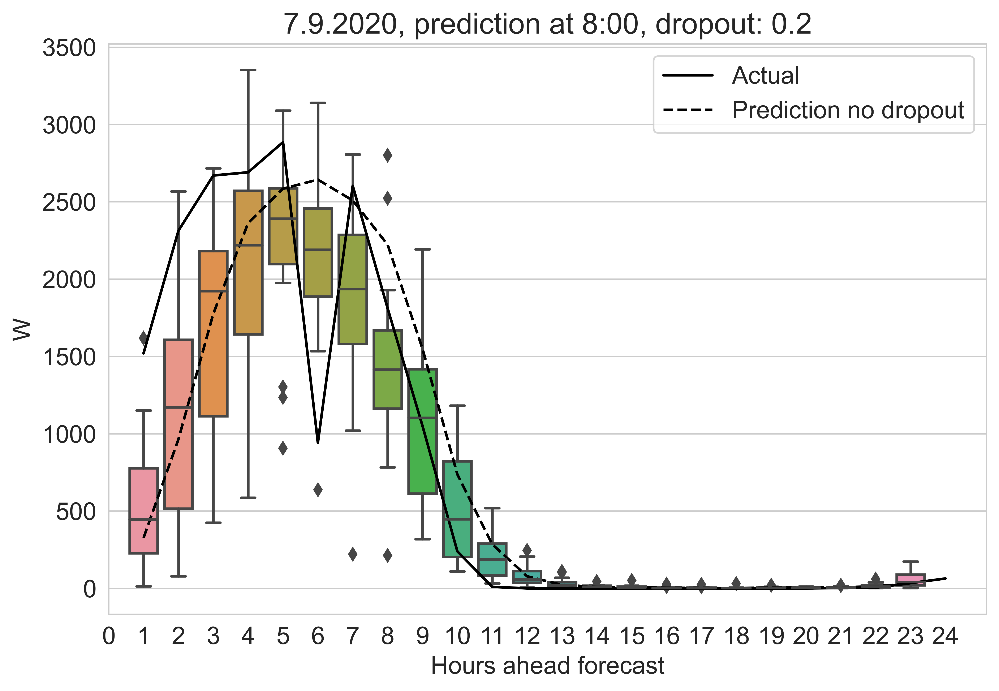

In [25]:
if evaluate_dropouts:
    # which dropout to plot
    best_dropout = [0.2]
    plot_dropout_results(data_PV_train,pred_variable, pred_det, pred_sto, n_hour_future, plot_boxplot = True, boxplot_dropouts = best_dropout)

## Optimization

In [26]:
from Model_Class import EV, House, Model
from MPC import run_MPC, run_MPC_save, time_prevision_method

from df_prepare import data_PV_csv, data_EV_csv
from df_prepare import prices_romande_energie

# get market prices
spot_prices = prices_romande_energie(data_EV)[['buy','sell']]

### Model Parameters

- EV

In [27]:
# EV battery
BC_EV = 16e3
# charging efficiency
eta_EV_ch = 0.95
# Max charging rate
P_EV_chmax = 3.7e3
# Max discharging rate
P_EV_dismax = 3.7e3
# lower bound SOC
SOC_min = 0.2
# bounds SOC
SOC_min = 0.2
SOC_max = 1


# EV and Household model
EV1 = EV(BC_EV = BC_EV, eta_EV_ch = eta_EV_ch, 
                        P_EV_chmax = P_EV_chmax, P_EV_dismax = P_EV_dismax, SOC_min = SOC_min, SOC_max = SOC_max)


- Household

In [28]:
# Installed PV capacity
installed_PV = 10000

House1 = House(installed_PV = installed_PV, pv_nominal = 2835)

### Weights evaluation

- Folder name

In [29]:
folder_weights = 'weights'

- Create folders

In [30]:
try:
    res_weights_folder_path = os.mkdir(folder_path + folder_weights+'/')
except:
    res_weights_folder_path = folder_path + folder_weights+'/'

- Parameters

In [31]:
# method ('opti = Perfect Foresight')
method = 'opti'

# objectives
objectives = ['cost', 'pv', 'peak']

# weight range
lambda_soc = np.arange(0,1.1,0.1)

# Episodes
episode_start = 1
n_episodes = 30

# V2X on or off
V2X = 1

- Do you want to evaluate weights? (True/False)

In [32]:
evaluate_weights = False

- Run

In [33]:
name = method

# range of episodes
range_episodes = range(episode_start, episode_start + n_episodes)

# csv code
if V2X:
    name = 'v2g_'+name


if evaluate_weights:
    
    # for each objective
    for objective_1 in objectives:
        # csv stuff
        speciality = '_'+objective_1
        
        # for each weight
        for l in lambda_soc:
            # for each episode
            for e in range_episodes:
                
                # data selection
                episode = data_EV[data_EV.episode == e]
                
                # time stuff
                t_start_episode = episode.index[0]
                t_end_episode = episode.index[-1]
                episode_length = episode.shape[0]
                
                # instantiate class
                model_0 = Model( data_EV = data_EV, t_start = t_start_episode, 
                          t_res = t_res,  EV = EV1, House = House1, spot_prices = spot_prices, V2X = V2X)
                
                # time of decision
                t_decision = t_start_episode
                
                # time of forecast
                t_forecast = episode.index[1]
                
                # predict PV and load from model
                PV_predictions_0 = episode.loc[t_forecast:t_end_episode,'PV'].to_frame()
                Load_predictions_0 = episode.loc[t_forecast:t_end_episode,'load'].to_frame()
                
                # run optimization
                model_0.optimize(t_decision, t_end_episode, PV_predictions_0,Load_predictions_0, 
                                  objective_1 = objective_1, forecasting = False, 
                                  method = 'deterministic', lambda_soc = l, verbose = False)
                
                # get results (decisions)
                decisions_0 = model_0.results_deterministic()

                if e == episode_start:

                    results = decisions_0.copy()

                else:

                    results = results.append(decisions_0)
                    
            # save as csv
            results.to_csv(res_weights_folder_path+f'results_{name}_{objective_1}_{np.round(l,5)}.csv')


- Import weight plotting function

In [34]:
from plot_weights import plot_weights

In [35]:
Run_weight_plot = True

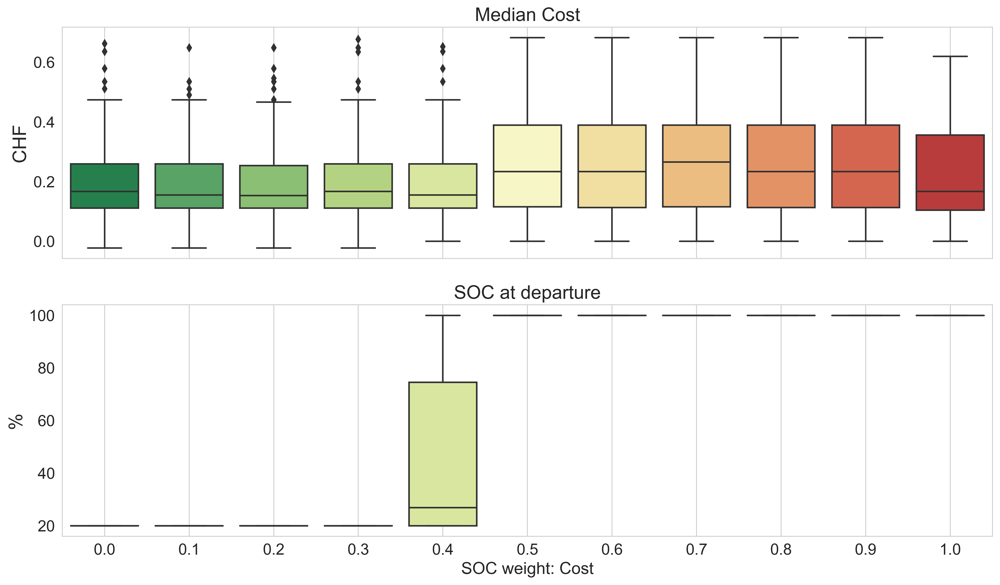

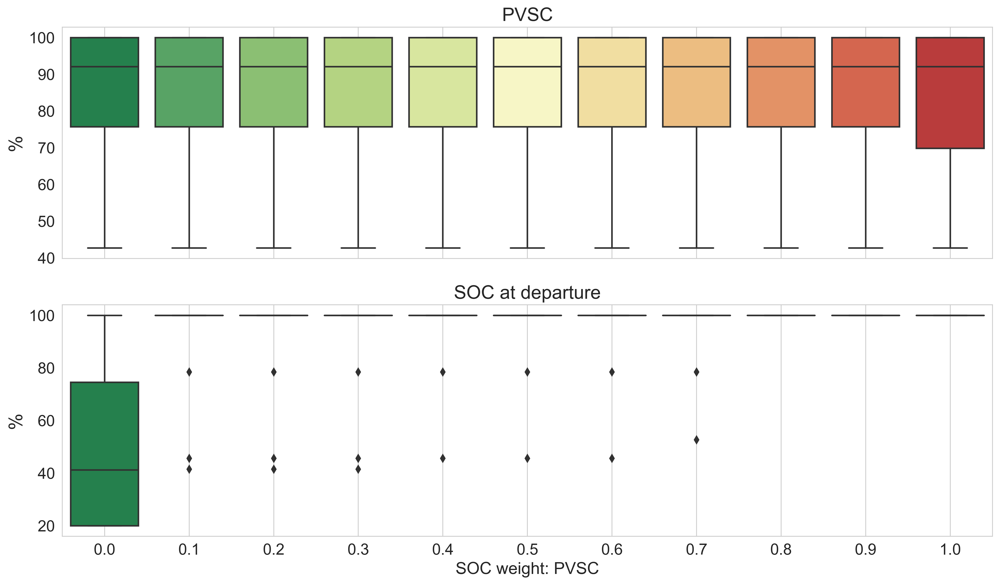

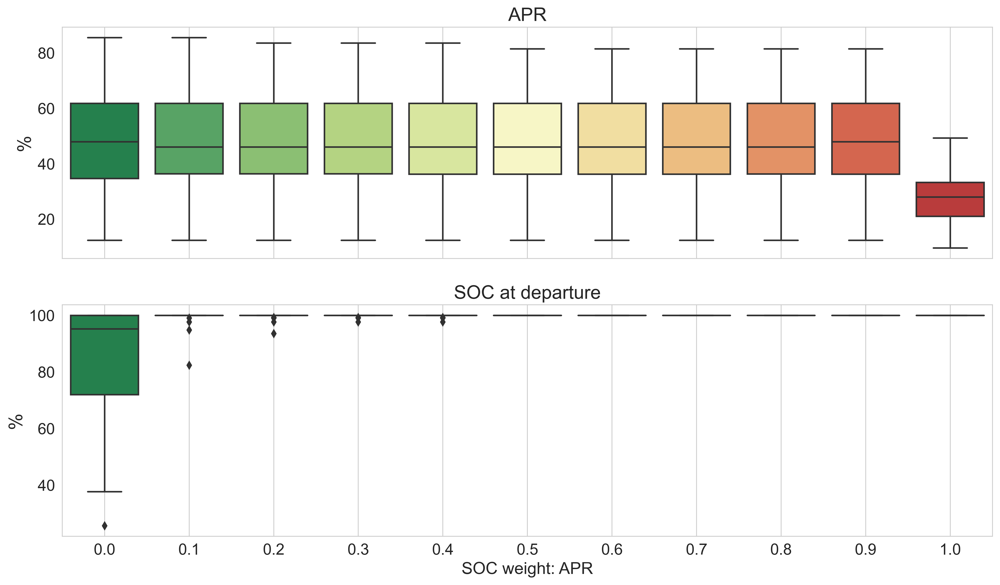

In [36]:
if Run_weight_plot:
    for obj in objectives:
        plot_weights(res_weights_folder_path, obj)

### MPC 

- Results Folder

In [37]:
folder_results = 'results_optimization'

In [38]:
try:
    res_folder_path = os.mkdir(folder_path + folder_results+'/')
except:
    res_folder_path = folder_path + folder_results+'/'

In [39]:
names = ['opti', 'mpc_d', 'mpc_s',  'mpc_s_cvar']

try:
    res_folder_path_all = os.mkdir(res_folder_path + 'all/')
except:
    res_folder_path_all = res_folder_path + 'all/'

res_folder_names = {}
for n in names:
    try:
        res_folder_name = os.mkdir(res_folder_path+n+'/')
    except:
        res_folder_name = res_folder_path+n+'/'
        
    res_folder_names[n] = res_folder_name

- Parameters

In [40]:
# MPC methods 
MPC_methods = ['mpc_d', 'mpc_s',  'mpc_s_cvar']

# objectives
objectives = ['cost', 'pv', 'peak']

# weights 
lambda_soc = {'cost': 0.5,
              'pv': 0.8,
              'peak': 0.4}

# Episodes
episode_start = 1
n_episodes = 30

# V2X on or off
V2X = 1

# number of scenario for stochastic predictions
num_scenario = 20

# Episodes
episode_start = 1
n_episodes = 10

# alpha CVaR
alpha_cvar = 0.75

- Run MPC optimization

_Careful time of execution_ !

In [41]:
MPC_run = False

- If you want to save intermediate results and predictions (not advised!)

In [42]:
save_mode = False

- Run

In [43]:
# intialization
num_iter = num_scenario

range_episodes = range(episode_start, episode_start + n_episodes)


if V2X:
    prefix = 'v2g_'
else:
    prefix = ''


MPC_opti_methods = {'mpc_d': 'deterministic', 'mpc_s': 'expected value',
                  'mpc_s_cvar': 'CVaR'}

MPC_parameters = {'mpc_d': None, 'mpc_s': None,
                  'mpc_s_cvar':{'alpha_obj1': alpha_cvar,
                                'alpha_soc': 0}}

# dict of time of execution
time_algo = {m:[] for m in MPC_methods}

if MPC_run:
    for objective_1 in objectives:
        for i,m in enumerate(MPC_methods):

            name = m
            
            # if save_mode
            predictions_load = {e: None for e in range_episodes}

            predictions_PV = {e: None for e in range_episodes}

            MPC_results = {e: None for e in range_episodes}
            
            # determine if stochastic or not
            if m == 'mpc_d':
                stochastic = False
            else:
                stochastic = True


            for e in range_episodes:
                
                # same as before
                episode = data_EV[data_EV.episode == e]
                t_start_episode = episode.index[0]
                t_end_episode = episode.index[-1]
                episode_length = episode.shape[0]


                # Fully deterministic
                start_0 = time.time()
                model_0 = Model( data_EV = data_EV, t_start = t_start_episode, 
                          t_res = t_res,  EV = EV1, House = House1, spot_prices = spot_prices, V2X = V2X)
                t_decision = t_start_episode
                t_forecast = episode.index[1]
                PV_predictions_0 = episode.loc[t_forecast:t_end_episode,'PV'].to_frame()
                Load_predictions_0 = episode.loc[t_forecast:t_end_episode,'load'].to_frame()
                model_0.optimize(t_decision, t_end_episode, PV_predictions_0,Load_predictions_0, 
                                  objective_1 = objective_1, forecasting = False, method = 'deterministic', lambda_soc = lambda_soc[objective_1])
                decisions_0 = model_0.results_deterministic()

                # estimate time progress
                if e > episode_start:
                    t_left = time_prevision_method(time_algo, m, episode_start + n_episodes -e)
                else:
                    t_left = 'unknown'
                # intialize
                start = time.time()
                model = Model(data_EV = data_EV, t_start = t_start_episode, 
                      t_res = t_res,  EV = EV1, House = House1, spot_prices = spot_prices, V2X = V2X)
                
                opti_method = MPC_opti_methods[m]
                opti_parameters = MPC_parameters[m]
                
                # run MPC
                if save_mode:
                    decisions, MPC_results[e], predictions_load[e], predictions_PV[e] = run_MPC_save(m, episode, model, decisions_0,
                                                                                                        Load_model_forecast, PV_model_forecast, PV_LSTM,
                                                                                                        opti_method, opti_parameters,
                                                                                                        n_hour_future,t_left)

                else:
                    decisions = run_MPC(m, episode, model, decisions_0, Load_model_forecast, PV_model_forecast, PV_LSTM,
                                                                                                            opti_method, opti_parameters, objective_1, 
                                                                                                            n_hour_future,t_left,
                                                                                                            lambda_soc = lambda_soc[objective_1], num_iter = num_iter,
                                                                                                            stochastic = stochastic)


                # save time
                end = time.time()
                total_ep = end - start
                time_algo[m].append(total_ep)                                                                                         


                if e == episode_start:

                    results = decisions.copy()

                else:

                    results = results.append(decisions)

                # save results as you go
                results.to_csv(res_folder_names[m]+f'results_{prefix}{name}_{objective_1}.csv')
                results.to_csv(res_folder_path_all+f'results_{prefix}{name}_{objective_1}.csv')
                file_inter = open(res_folder_path_all+f'time_{prefix}{name}_{objective_1}.pickle', 'wb') 
                pickle.dump(time_algo[m], file_inter)
                file_inter.close()

            # if intermediate results needed
            if save_mode:
                intermediate_results = {'PV forecast': predictions_PV,
                                        'Load forecast': predictions_load,
                                        'Decisions': MPC_results}

                file_inter = open(res_folder_path+f'Intermediate_results_{name}_{e}.pickle', 'wb') 
                pickle.dump(intermediate_results, file_inter)
                file_inter.close()


### Perfect foresight

- Run PF optmization

In [44]:
PF_run = False

- Parameters

In [45]:
objectives = ['cost', 'pv', 'peak']

episode_start = 1
n_episodes = 30

- Run

In [46]:
# same methods as commented above
range_episodes = range(episode_start, episode_start + n_episodes)
               

name = 'opti'

v2x_values = [0,1]


if PF_run:  
    for objective_1 in objectives:

        speciality = '_'+objective_1

        for v2x in v2x_values:
            time_algo = []
            V2X = v2x
            if V2X:
                prefix = 'v2g_'
            else:
                prefix = 'v1g_'

            for e in range_episodes:
                start_0 = time.time()
                episode = data_EV[data_EV.episode == e]
                t_start_episode = episode.index[0]
                t_end_episode = episode.index[-1]
                episode_length = episode.shape[0]

                model_0 = Model( data_EV = data_EV, t_start = t_start_episode, 
                          t_res = t_res,  EV = EV1, House = House1, spot_prices = spot_prices, V2X = V2X)
                t_decision = t_start_episode
                t_forecast = episode.index[1]
                PV_predictions_0 = episode.loc[t_forecast:t_end_episode,'PV'].to_frame()
                Load_predictions_0 = episode.loc[t_forecast:t_end_episode,'load'].to_frame()

                model_0.optimize(t_decision, t_end_episode, PV_predictions_0,Load_predictions_0, 
                                  objective_1 = objective_1, forecasting = False, 
                                  method = 'deterministic', lambda_soc = lambda_soc[objective_1], verbose = False)

                decisions_0 = model_0.results_deterministic()

                end_0 = time.time()

                time_algo.append(end_0 - start_0)

                if e == episode_start:

                    results = decisions_0.copy()

                else:

                    results = results.append(decisions_0)

            results.to_csv(res_folder_names[name]+f'results_{prefix}{name}_{objective_1}.csv')
            results.to_csv(res_folder_path_all+f'results_{prefix}{name}_{objective_1}.csv')

            file_inter = open(res_folder_path_all+f'time_{prefix}{name}_{objective_1}.pickle', 'wb') 
            pickle.dump(time_algo, file_inter)
            file_inter.close()

### EV management

In [47]:
from plot_all_EV import plot_all_EV

- Select series of episodes to be plotted

In [48]:
episodes = [[6,7],[8,9,10]]

- Plot

In [49]:
Run_EV_plot = True

In [50]:
if Run_EV_plot:
    plot_all_EV(res_folder_path_all,episodes)

### V2X variation

Make sure you have one method run with all objectives in v1x and v2x

In [51]:
from V2X_variation import V2X_VARIATION

- Choose which method to evaluate

In [52]:
method = 'opti'

- Instantiate

In [55]:
res_folder_path_all

'C:\\Users\\Yann\\Documents\\EPFL\\pdm_git\\pdm_git\\Main/results_optimization/all/'

In [53]:
v2x_v = V2X_VARIATION(res_folder_path_all,'opti')


- Import results

In [54]:
v2x_v.import_decisions()

KeyError: 'Cost'

- Plot each objective complete analysis

In [ ]:
v2x_v.plot_complete_graph()

- Plot variation per objective and respective metric

In [ ]:
v2x_v.plot_all_obj()

- Plot each objective with all metrics

In [ ]:
v2x_v.plot_variation_per_objective()

### Metrics

In [ ]:
from Metrics import Metrics_groups

- Instantiate class

In [ ]:
m_groups = Metrics_groups(res_folder_path_all)

- Import decisions

In [ ]:
res_folder_path_all

In [ ]:
m_groups.import_decisions()

- Plot exectution time

In [ ]:
m_groups.plot_time()

- Plot Heatmap of objectives

In [ ]:
m_groups.heatmap_obj()

- Plot each group full

In [ ]:
 m_groups.plot_groups()

- Plot SOC comparison per group

In [ ]:
m_groups.plot_SOC()

# Thanks for going through!